In [1]:
import os
import random
import time
import datetime
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from tqdm import tqdm

In [2]:
from PIL import Image
def get_shape_from_pil(path):
    image = Image.open(path)
    width = image.size[0]
    height = image.size[1]
    return (width, height)
def get_shape_from_exif(path):
    image = Image.open(path)
    size = image.size
    width = image._getexif()[256] if (image._getexif() is not None and 256 in image._getexif()) else None
    height = image._getexif()[257] if (image._getexif() is not None and 257 in image._getexif()) else None
    return (width, height)

In [3]:
import cv2
def get_shape_from_cv2(path):
    image = cv2.imread(path)
    height, width, channel = image.shape
    return (width, height)


In [4]:
def load_image_and_resize(path, new_size=224, resize_method="resize", padding_method="wrap", rotate=False, crop_ratio=0.5, crop_center=None):
    """Use CV2 to read image, and resize the image to make the aspect ratio.

    Arguments:
    ----------
        path: string, default=None
            image path. 

        new_size: number, default=500
            desired image size.

        resize_method: 'resize' or 'padding', default='resize'
            resize: only resize.
            padding: padding and resize.

        padding_method: 'wrap' or 'constant'
            wrap: take mirrored pixel padding.
            constant: border padding to a fixed value.
        
        crop_ratio: number, default=0.5
            The ratio of the clipping box to the target size.

    Returns:
    --------
        image_rgb: 3d-array
            image vector converted to rgb format.
    """
    image = cv2.imread(path)
    height, width, channel = image.shape

    if resize_method == "padding":
        # resize by ratio
        ratio = new_size / max(height, width)
        new_height, new_width = int(ratio * height), int(ratio * width)
        image = cv2.resize(image, (new_width, new_height))

        # calculate boundaries
        top, bottom = (new_size-new_height) // 2, (new_size-new_height) // 2
        if top + bottom + height < new_size:
            bottom += 1
        left, right = (new_size-new_width) // 2, (new_size-new_width) // 2
        if left + right + width < new_size:
            right += 1

        # padding
        if padding_method == "wrap":
            image = cv2.copyMakeBorder(
                image, top, bottom, left, right, cv2.BORDER_WRAP)
        elif padding_method == "constant":
            image = cv2.copyMakeBorder(image, top, bottom, left, right, cv2.BORDER_CONSTANT, value=0)
    if(rotate):
        image = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [5]:

# Top level data directory. Here we assume the format of the directory conforms to the ImageFolder structure
path = "."
# path = "/content/drive/MyDrive/Colab Notebooks/aidea-farmland-crops-autumn"

# Folder of the training data
training_folder = 'D:/Dataset/aidea-farmland-crops-autumn/train'

# Folder of the public data
public_folder = 'D:/Dataset/aidea-farmland-crops-autumn/public'

# Number of classes in the dataset
num_classes = 33

# Image size for model
image_size = 224

# options: (subset, fullset)
train_mode = 'subset'

# Whether to reprocess the data
reprocess = False

# Get the shape of the input layer
input_shape = (image_size, image_size, 3)

In [6]:
data = pd.read_csv(F"{path}/sample/image_angle_correct/tag.csv")
labels = data.groupby('label').count().reset_index()['label']

## View

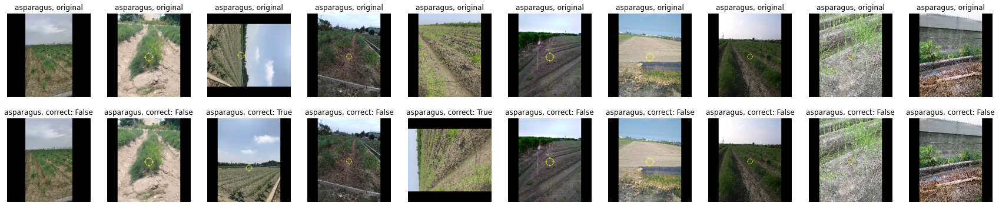

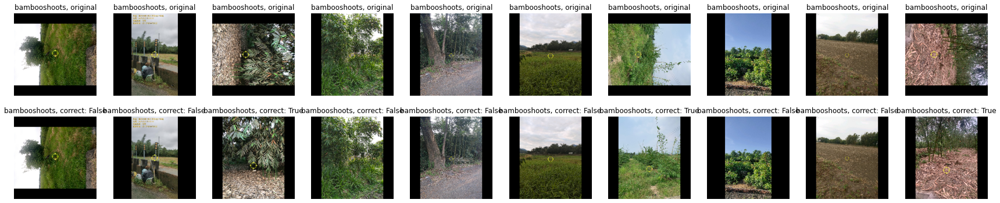

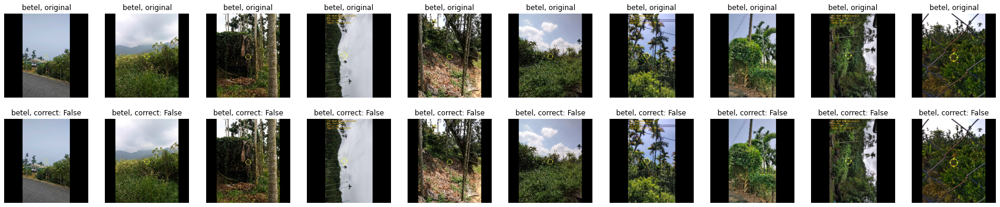

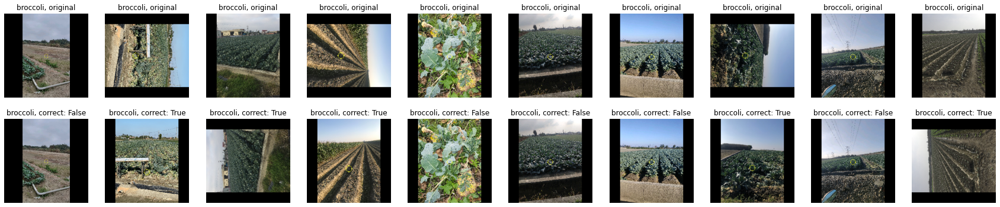

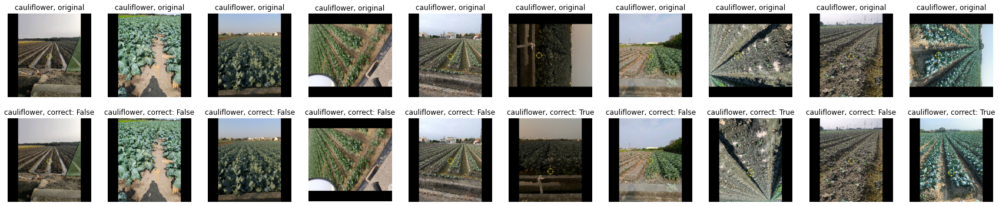

...

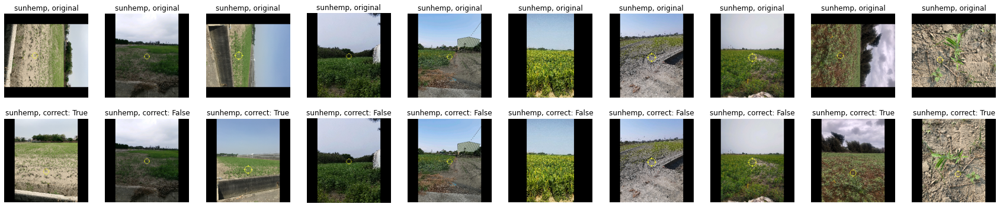

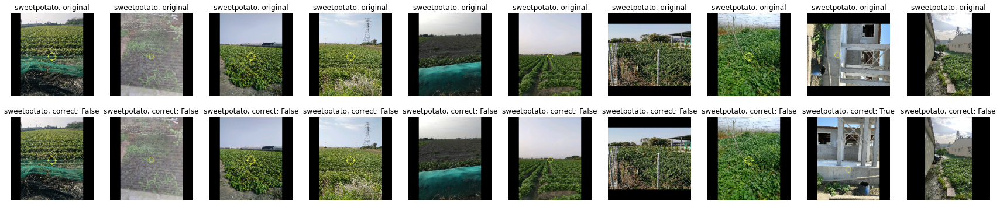

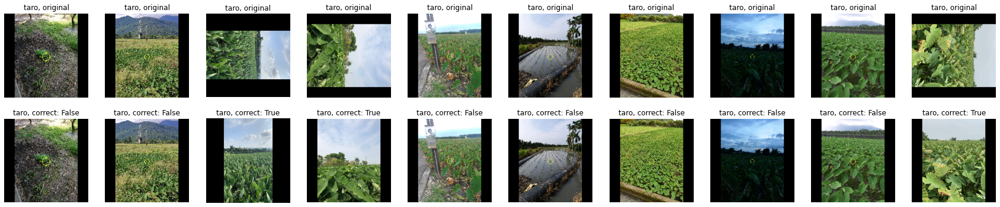

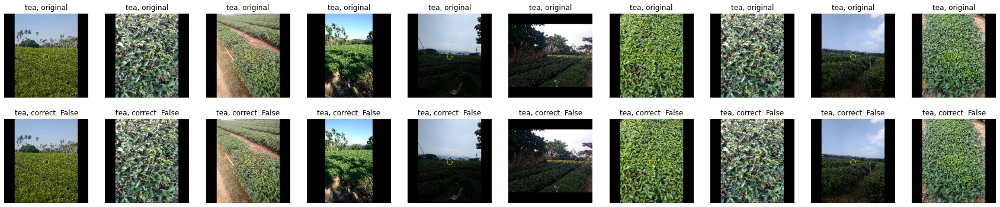

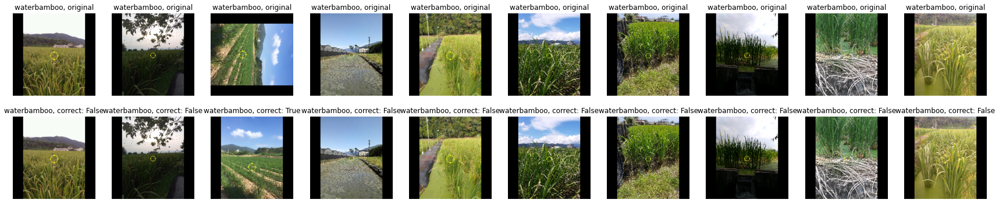

In [66]:
def row_based_idx(num_rows, num_cols, idx):
    return np.arange(1, num_rows*num_cols + 1).reshape((num_rows, num_cols)).transpose().flatten()[idx-1]

items = 10
variants = 1
for label in labels:
    plt.figure(figsize=(items * 3, variants * 6))
    filter_by_label = data[data['label'].eq(label)].reset_index(drop=True)
    for item in range(items):
        row = filter_by_label.iloc[item]
        filepath = F'{training_folder}/{row["label"]}/{row["file"]}'
        shape_from_pil = get_shape_from_pil(filepath)
        shape_from_cv2 = get_shape_from_cv2(filepath)
        original = load_image_and_resize(filepath, image_size, resize_method="padding", padding_method="constant", rotate=False)
        correct = load_image_and_resize(filepath, image_size, resize_method="padding", padding_method="constant", rotate=shape_from_pil != shape_from_cv2)
        # plot - original
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, item * (variants + 1) + 1))
        plt.imshow(original)
        plt.title("{}, original".format(row["label"]))
        plt.axis('off')
        # plot - correct
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, item * (variants + 1) + 2))
        plt.imshow(correct)
        # plt.title("{}, correct".format(row["label"]))
        plt.title("{}, correct: {}".format(row["label"], shape_from_pil != shape_from_cv2))
        plt.axis('off')
    plt.show()

## Result

In [7]:
from sklearn.metrics import classification_report

def evaluate(y_true, y_pred,zero_division = 1):
    labels = sorted(list(set(y_true + y_pred)))
    eval_result = classification_report(
        y_true, y_pred, target_names=labels, 
        output_dict=True, zero_division=zero_division
    )
    return eval_result

In [8]:
data = pd.read_csv(F"{path}/sample/image_angle_correct/tag.csv")
pd.DataFrame(evaluate(data['angle'].tolist(), data['correct.2'].tolist())).T

,precision,recall,f1-score,support
0,0.946721,0.939024,0.942857,246.000000
90,0.813953,0.897436,0.853659,78.000000
180,1.000000,0.000000,0.000000,1.000000
270,1.000000,0.000000,0.000000,5.000000
accuracy,0.912121,0.912121,0.912121,0.912121
macro avg,0.940169,0.459115,0.449129,330.000000
weighted avg,0.916309,0.912121,0.904631,330.000000


## Correct

In [15]:
train_tag_loc_coor_describe_elevation = pd.read_csv(F'{path}/data/train_tag_loc_coor_describe_elevation.csv')
train_tag_loc_coor_describe_elevation['angle'] = 0
for i in range(len(train_tag_loc_coor_describe_elevation)):
    row = train_tag_loc_coor_describe_elevation.iloc[i]
    file_path = F'{training_folder}/{row["label"]}/{row["file"]}'
    shape_from_pil = get_shape_from_pil(file_path)
    shape_from_cv2 = get_shape_from_cv2(file_path)
    train_tag_loc_coor_describe_elevation.loc[i, 'angle'] = 90 if (shape_from_pil != shape_from_cv2) else 0
    train_tag_loc_coor_describe_elevation.loc[i, 'width'] = shape_from_cv2[0]
    train_tag_loc_coor_describe_elevation.loc[i, 'height'] = shape_from_cv2[1]

KeyboardInterrupt: 